In [1]:
!pip install ipywidgets

You should consider upgrading via the 'C:\ProgramData\Anaconda3\envs\venai_1\python.exe -m pip install --upgrade pip' command.


In [1]:
!pip install pandas_profiling --user

  Consider adding this directory to PATH or, if you prefer to suppress this warning, use --no-warn-script-location.
  Consider adding this directory to PATH or, if you prefer to suppress this warning, use --no-warn-script-location.
You should consider upgrading via the 'C:\ProgramData\Anaconda3\envs\venai_1\python.exe -m pip install --upgrade pip' command.



  Using cached pandas_profiling-3.2.0-py2.py3-none-any.whl (262 kB)
  Using cached phik-0.12.2-cp38-cp38-win_amd64.whl (677 kB)
  Using cached missingno-0.5.1-py3-none-any.whl (8.7 kB)
  Using cached visions-0.7.4-py3-none-any.whl (102 kB)
  Using cached ImageHash-4.2.1-py2.py3-none-any.whl


In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from pandas_profiling import ProfileReport
import seaborn as sns

In [3]:
import warnings
warnings.filterwarnings("ignore")

In [4]:
df = pd.read_csv('avocado.csv')
df = df.iloc[:, 1:]
df

,Date,AveragePrice,Total Volume,4046,4225,4770,Total Bags,Small Bags,Large Bags,XLarge Bags,type,year,region
0,2015-12-27,1.33,64236.62,1036.74,54454.85,48.16,8696.87,8603.62,93.25,0.0,conventional,2015,Albany
1,2015-12-20,1.35,54876.98,674.28,44638.81,58.33,9505.56,9408.07,97.49,0.0,conventional,2015,Albany
2,2015-12-13,0.93,118220.22,794.70,109149.67,130.50,8145.35,8042.21,103.14,0.0,conventional,2015,Albany
3,2015-12-06,1.08,78992.15,1132.00,71976.41,72.58,5811.16,5677.40,133.76,0.0,conventional,2015,Albany
4,2015-11-29,1.28,51039.60,941.48,43838.39,75.78,6183.95,5986.26,197.69,0.0,conventional,2015,Albany
...,...,...,...,...,...,...,...,...,...,...,...,...,...
18244,2018-02-04,1.63,17074.83,2046.96,1529.20,0.00,13498.67,13066.82,431.85,0.0,organic,2018,WestTexNewMexico
18245,2018-01-28,1.71,13888.04,1191.70,3431.50,0.00,9264.84,8940.04,324.80,0.0,organic,2018,WestTexNewMexico
18246,2018-01-21,1.87,13766.76,1191.92,2452.79,727.94,9394.11,9351.80,42.31,0.0,organic,2018,WestTexNewMexico
18247,2018-01-14,1.93,16205.22,1527.63,2981.04,727.01,10969.54,10919.54,50.00,0.0,organic,2018,WestTexNewMexico


In [5]:
profile = ProfileReport(df, title = "Avocado Pandas Profill Report", html={'style':{'full_width': True} })

In [6]:
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

# Part II) Chect the correlation between 'Type', 'Region' with 'AveragePrice'

## 1)'Type' with 'AveragePrice' (density and probability)

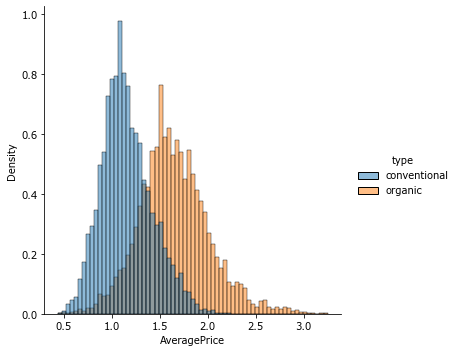

In [7]:
sns.displot(df, x='AveragePrice', hue='type', stat = 'density')
plt.show()

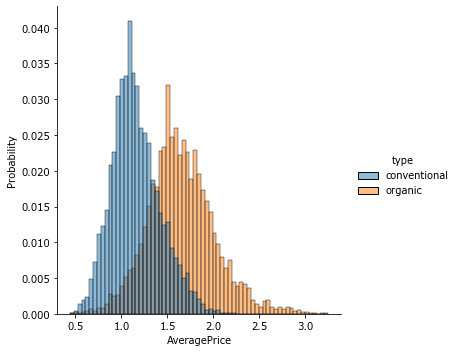

In [8]:
sns.displot(df, x='AveragePrice', hue='type', stat = 'probability')
plt.show()

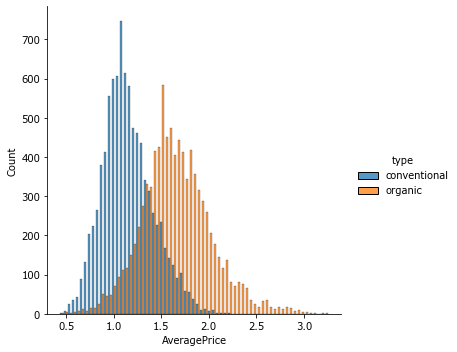

In [9]:
sns.displot(df, x= 'AveragePrice', hue='type', multiple='dodge')
plt.show()

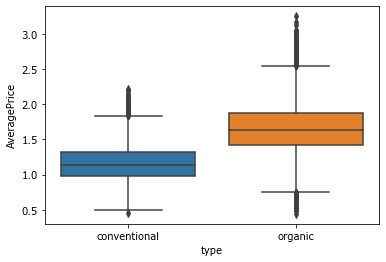

In [10]:
sns.boxplot(data = df, x='type', y='AveragePrice')
plt.show()

## 2)'Region' with 'AveragePrice'

* On organic

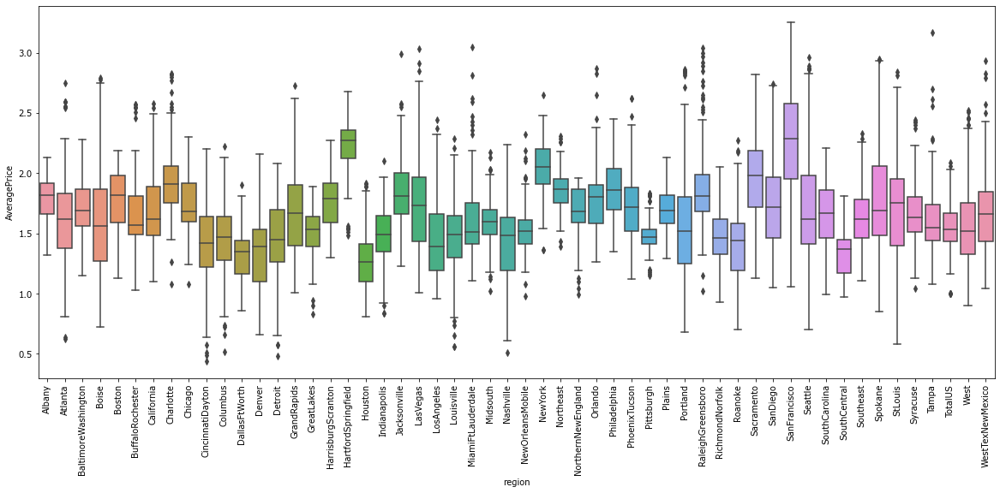

In [11]:
fig, ax = plt.subplots(figsize=(20,8))

sns.boxplot(data=df.query('type == "organic"'),
          x='region',
          y='AveragePrice',
          ax = ax)

plt.xticks(rotation=90) # for X values rotation

plt.show()

* On conventional

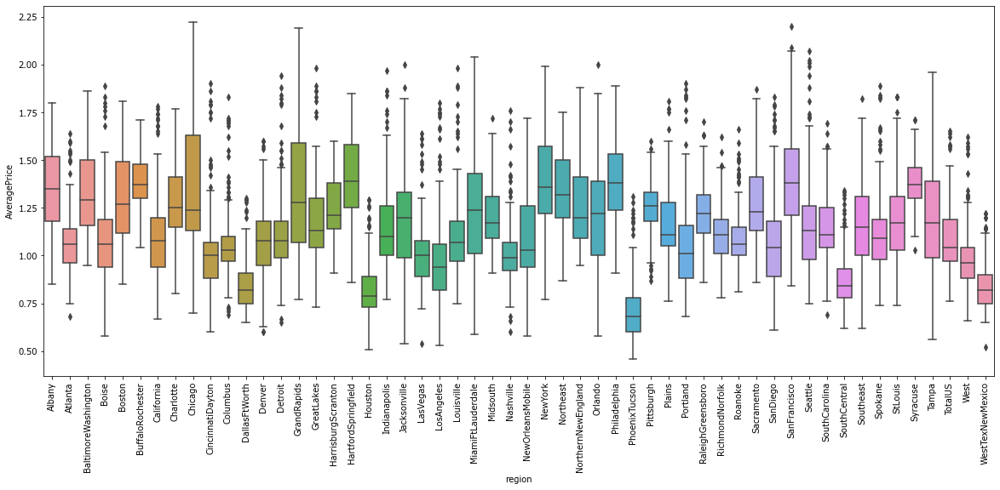

In [12]:
fig, ax = plt.subplots(figsize=(20,8))

sns.boxplot(data = df.query('type == "conventional"'),
           x='region',
           y = 'AveragePrice',
           ax=ax)

plt.xticks(rotation=90)
plt.show()


## 3) Price analyze

* For Organic

In [13]:
df_orga = df.query('type == "organic"')

In [14]:
df_orga['AveragePrice'].describe()

count    9123.000000
mean        1.653999
std         0.363502
min         0.440000
25%         1.420000
50%         1.630000
75%         1.870000
max         3.250000
Name: AveragePrice, dtype: float64

In [15]:
price_highest_or = df_orga.query('AveragePrice == 3.25')
price_highest_or

,Date,AveragePrice,Total Volume,4046,4225,4770,Total Bags,Small Bags,Large Bags,XLarge Bags,type,year,region
14125,2016-10-30,3.25,16700.94,2325.93,11142.85,0.0,3232.16,3232.16,0.0,0.0,organic,2016,SanFrancisco


In [16]:
price_lowest_or = df_orga.query('AveragePrice == 0.44')
price_lowest_or

,Date,AveragePrice,Total Volume,4046,4225,4770,Total Bags,Small Bags,Large Bags,XLarge Bags,type,year,region
15261,2017-03-05,0.44,64057.04,223.84,4748.88,0.0,59084.32,638.68,58445.64,0.0,organic,2017,CincinnatiDayton


* For conventional

In [17]:
df_conv = df.query('type == "conventional"')

In [18]:
df_conv['AveragePrice'].describe()

count    9126.000000
mean        1.158040
std         0.263041
min         0.460000
25%         0.980000
50%         1.130000
75%         1.320000
max         2.220000
Name: AveragePrice, dtype: float64

In [19]:
price_highest_conv = df_conv.query('AveragePrice == 2.22')
price_highest_conv

,Date,AveragePrice,Total Volume,4046,4225,4770,Total Bags,Small Bags,Large Bags,XLarge Bags,type,year,region
6052,2017-10-08,2.22,516320.59,62315.4,296817.34,87406.94,69780.91,66070.17,3699.01,11.73,conventional,2017,Chicago


In [20]:
price_lowest_conv = df_conv.query('AveragePrice == 0.46')
price_lowest_conv

,Date,AveragePrice,Total Volume,4046,4225,4770,Total Bags,Small Bags,Large Bags,XLarge Bags,type,year,region
7412,2017-02-05,0.46,2200550.27,1200632.86,531226.65,18324.93,450365.83,113752.17,330583.1,6030.56,conventional,2017,PhoenixTucson


## 4) Conclusion:

both 'Type', 'Region' effect 'AveragePrice'

# Part III) Continuous Features effect 'AveragePrice'

## 1) Correlation

In [21]:
corr = df.corr()
corr

,AveragePrice,Total Volume,4046,4225,4770,Total Bags,Small Bags,Large Bags,XLarge Bags,year
AveragePrice,1.000000,-0.192752,-0.208317,-0.172928,-0.179446,-0.177088,-0.174730,-0.172940,-0.117592,0.093197
Total Volume,-0.192752,1.000000,0.977863,0.974181,0.872202,0.963047,0.967238,0.880640,0.747157,0.017193
4046,-0.208317,0.977863,1.000000,0.926110,0.833389,0.920057,0.925280,0.838645,0.699377,0.003353
4225,-0.172928,0.974181,0.926110,1.000000,0.887855,0.905787,0.916031,0.810015,0.688809,-0.009559
4770,-0.179446,0.872202,0.833389,0.887855,1.000000,0.792314,0.802733,0.698471,0.679861,-0.036531
Total Bags,-0.177088,0.963047,0.920057,0.905787,0.792314,1.000000,0.994335,0.943009,0.804233,0.071552
Small Bags,-0.174730,0.967238,0.925280,0.916031,0.802733,0.994335,1.000000,0.902589,0.806845,0.063915
Large Bags,-0.172940,0.880640,0.838645,0.810015,0.698471,0.943009,0.902589,1.000000,0.710858,0.087891
XLarge Bags,-0.117592,0.747157,0.699377,0.688809,0.679861,0.804233,0.806845,0.710858,1.000000,0.081033
year,0.093197,0.017193,0.003353,-0.009559,-0.036531,0.071552,0.063915,0.087891,0.081033,1.000000


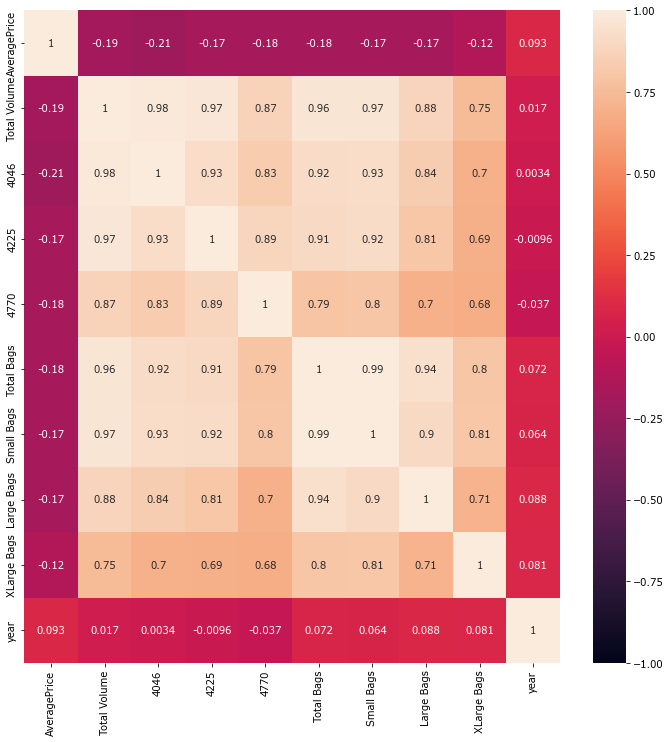

In [22]:
fig, ax = plt.subplots(figsize=(12, 12))

sns.heatmap(corr, vmin=-1, vmax=1, annot=True)

plt.show()

* Conclution in correlation:
    
    Every Independent Features don't have high correlation with Dependent Feature 
    
    The "Total Volume" Feature have high correlation with "4046", "4225", "4770" Features
    
    The "Total Bags" Feature have high correlation with "Small Bag", "Large Bags", "XLarge Bags" Features
    
    
 * There will be low Accuracy for linearity model, best use decision tree base model
 
 
 * We can use both "Total Volume", "Total Bags" features for model training without the sub-features like: "Small Bag", "Large Bags", "XLarge Bags"

# Part IV ) Check data values

In [23]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 18249 entries, 0 to 18248
Data columns (total 13 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   Date          18249 non-null  object 
 1   AveragePrice  18249 non-null  float64
 2   Total Volume  18249 non-null  float64
 3   4046          18249 non-null  float64
 4   4225          18249 non-null  float64
 5   4770          18249 non-null  float64
 6   Total Bags    18249 non-null  float64
 7   Small Bags    18249 non-null  float64
 8   Large Bags    18249 non-null  float64
 9   XLarge Bags   18249 non-null  float64
 10  type          18249 non-null  object 
 11  year          18249 non-null  int64  
 12  region        18249 non-null  object 
dtypes: float64(9), int64(1), object(3)
memory usage: 1.8+ MB


In [24]:
df.isna().any()

Date            False
AveragePrice    False
Total Volume    False
4046            False
4225            False
4770            False
Total Bags      False
Small Bags      False
Large Bags      False
XLarge Bags     False
type            False
year            False
region          False
dtype: bool

In [25]:
df.duplicated().any()

False

In [26]:
df.shape

(18249, 13)

In [27]:
np.corrcoef(df['AveragePrice'], df.iloc[:, 2 ])

array([[ 1.        , -0.19275239],
       [-0.19275239,  1.        ]])

In [28]:
np.corrcoef(df['AveragePrice'], df.iloc[:, 6])

array([[ 1.        , -0.17708793],
       [-0.17708793,  1.        ]])

# Part V) Chect the correlation between time base features with 'AveragePrice'

In [29]:
def convert_month(month):
    if month == 3 or month == 4 or month == 5:
        return 0
    elif month == 6 or month == 7 or month == 8:
        return 1
    elif month == 9 or month == 10 or month == 11:
        return 2
    elif month == 12 or month == 1 or month == 2:
        return 3

In [30]:
df['Date'] = pd.to_datetime(df['Date'])

In [31]:
df['Month'] = pd.DatetimeIndex(df['Date']).month

In [32]:
df['Season'] = df['Month'].apply(lambda x: convert_month(x))

In [33]:
df

,Date,AveragePrice,Total Volume,4046,4225,4770,Total Bags,Small Bags,Large Bags,XLarge Bags,type,year,region,Month,Season
0,2015-12-27,1.33,64236.62,1036.74,54454.85,48.16,8696.87,8603.62,93.25,0.0,conventional,2015,Albany,12,3
1,2015-12-20,1.35,54876.98,674.28,44638.81,58.33,9505.56,9408.07,97.49,0.0,conventional,2015,Albany,12,3
2,2015-12-13,0.93,118220.22,794.70,109149.67,130.50,8145.35,8042.21,103.14,0.0,conventional,2015,Albany,12,3
3,2015-12-06,1.08,78992.15,1132.00,71976.41,72.58,5811.16,5677.40,133.76,0.0,conventional,2015,Albany,12,3
4,2015-11-29,1.28,51039.60,941.48,43838.39,75.78,6183.95,5986.26,197.69,0.0,conventional,2015,Albany,11,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
18244,2018-02-04,1.63,17074.83,2046.96,1529.20,0.00,13498.67,13066.82,431.85,0.0,organic,2018,WestTexNewMexico,2,3
18245,2018-01-28,1.71,13888.04,1191.70,3431.50,0.00,9264.84,8940.04,324.80,0.0,organic,2018,WestTexNewMexico,1,3
18246,2018-01-21,1.87,13766.76,1191.92,2452.79,727.94,9394.11,9351.80,42.31,0.0,organic,2018,WestTexNewMexico,1,3
18247,2018-01-14,1.93,16205.22,1527.63,2981.04,727.01,10969.54,10919.54,50.00,0.0,organic,2018,WestTexNewMexico,1,3


In [34]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 18249 entries, 0 to 18248
Data columns (total 15 columns):
 #   Column        Non-Null Count  Dtype         
---  ------        --------------  -----         
 0   Date          18249 non-null  datetime64[ns]
 1   AveragePrice  18249 non-null  float64       
 2   Total Volume  18249 non-null  float64       
 3   4046          18249 non-null  float64       
 4   4225          18249 non-null  float64       
 5   4770          18249 non-null  float64       
 6   Total Bags    18249 non-null  float64       
 7   Small Bags    18249 non-null  float64       
 8   Large Bags    18249 non-null  float64       
 9   XLarge Bags   18249 non-null  float64       
 10  type          18249 non-null  object        
 11  year          18249 non-null  int64         
 12  region        18249 non-null  object        
 13  Month         18249 non-null  int64         
 14  Season        18249 non-null  int64         
dtypes: datetime64[ns](1), float64(9), in

* For organic

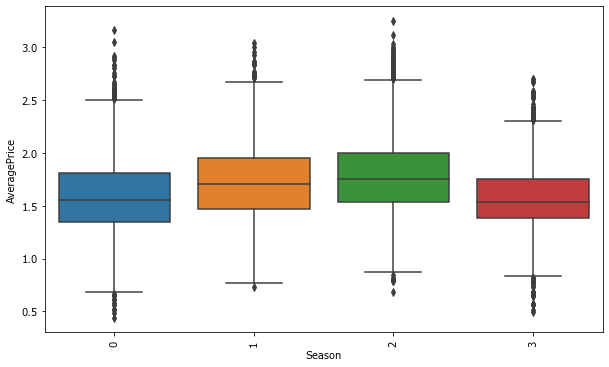

In [35]:
fix, ax = plt.subplots(figsize=(10,6))

sns.boxplot(data = df.query('type == "organic"'),
             x = 'Season',             
             y = 'AveragePrice',
             ax = ax)

plt.xticks(rotation=90)

plt.show()

* For conventional

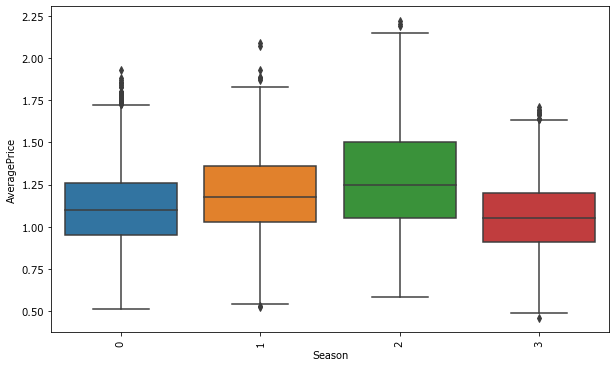

In [36]:
fix, ax = plt.subplots(figsize=(10,6))

sns.boxplot(data = df.query('type == "conventional"'),
             x = 'Season',             
             y = 'AveragePrice',
             ax = ax)

plt.xticks(rotation=90)

plt.show()

## Part VI) Show Average Price of each Avocado in each city of each year 

In [37]:
df_con = df.query('type == "conventional"')
df_con

,Date,AveragePrice,Total Volume,4046,4225,4770,Total Bags,Small Bags,Large Bags,XLarge Bags,type,year,region,Month,Season
0,2015-12-27,1.33,64236.62,1036.74,54454.85,48.16,8696.87,8603.62,93.25,0.00,conventional,2015,Albany,12,3
1,2015-12-20,1.35,54876.98,674.28,44638.81,58.33,9505.56,9408.07,97.49,0.00,conventional,2015,Albany,12,3
2,2015-12-13,0.93,118220.22,794.70,109149.67,130.50,8145.35,8042.21,103.14,0.00,conventional,2015,Albany,12,3
3,2015-12-06,1.08,78992.15,1132.00,71976.41,72.58,5811.16,5677.40,133.76,0.00,conventional,2015,Albany,12,3
4,2015-11-29,1.28,51039.60,941.48,43838.39,75.78,6183.95,5986.26,197.69,0.00,conventional,2015,Albany,11,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9121,2018-02-04,0.76,1272039.80,531469.08,368948.26,13078.20,358544.26,127833.03,229786.03,925.20,conventional,2018,WestTexNewMexico,2,3
9122,2018-01-28,0.85,957086.16,479147.93,179489.19,7314.98,291134.06,143430.96,147376.43,326.67,conventional,2018,WestTexNewMexico,1,3
9123,2018-01-21,0.84,1020913.20,505263.29,177911.40,9468.95,328269.56,118978.50,209131.06,160.00,conventional,2018,WestTexNewMexico,1,3
9124,2018-01-14,0.90,950954.60,463945.73,188126.02,11227.47,287655.38,125408.69,162040.02,206.67,conventional,2018,WestTexNewMexico,1,3


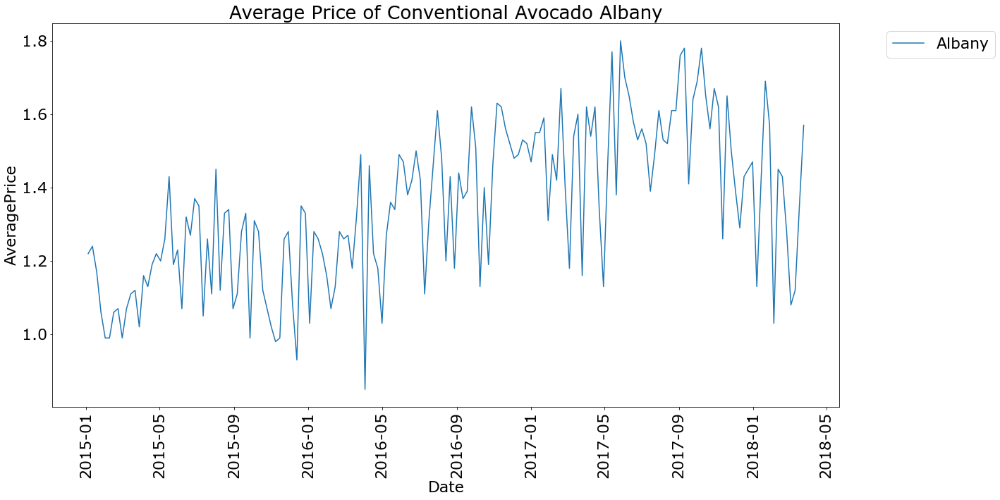

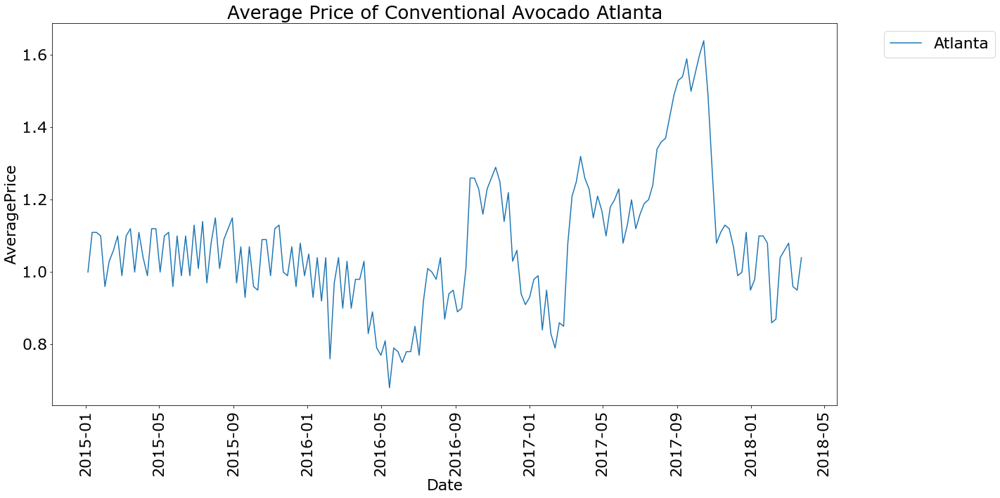

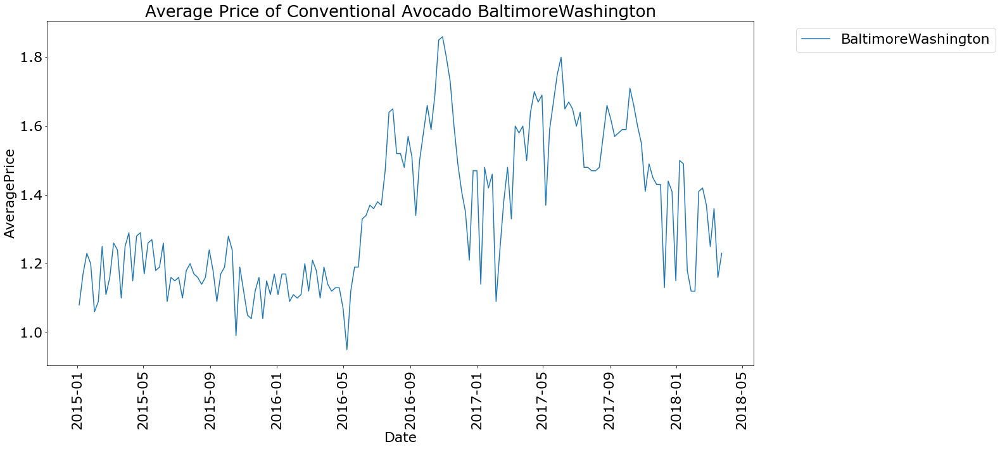

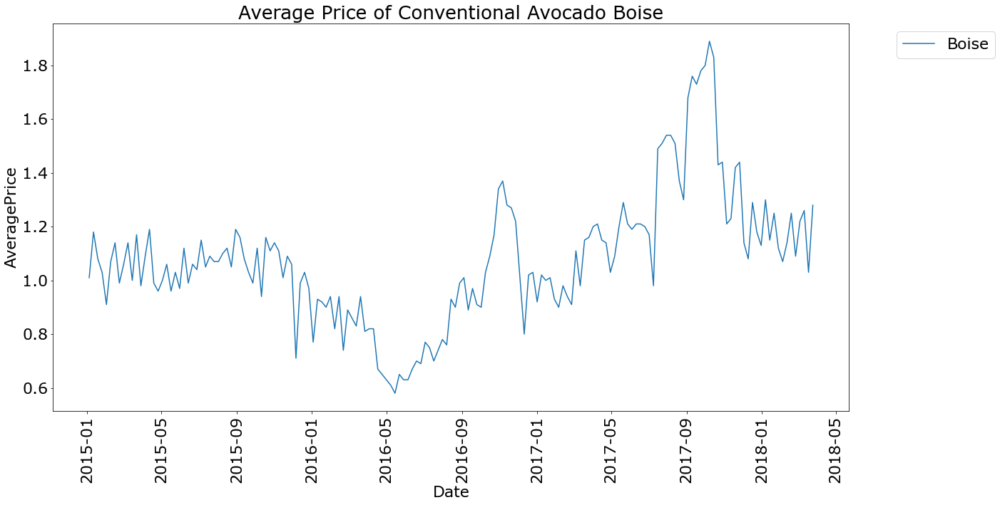

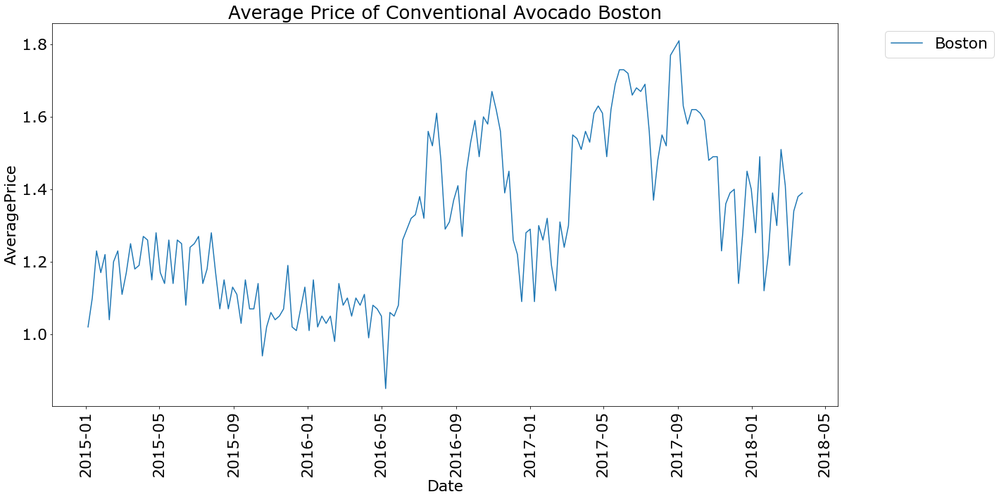

...

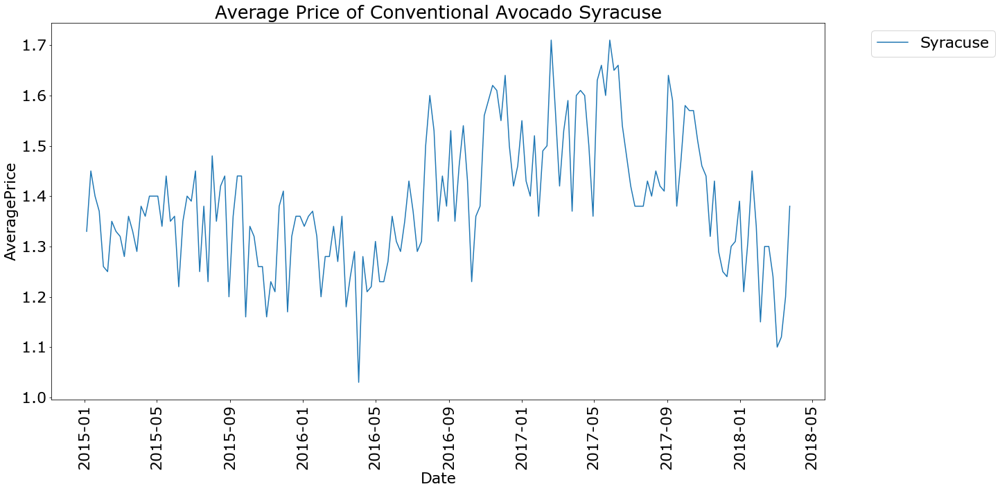

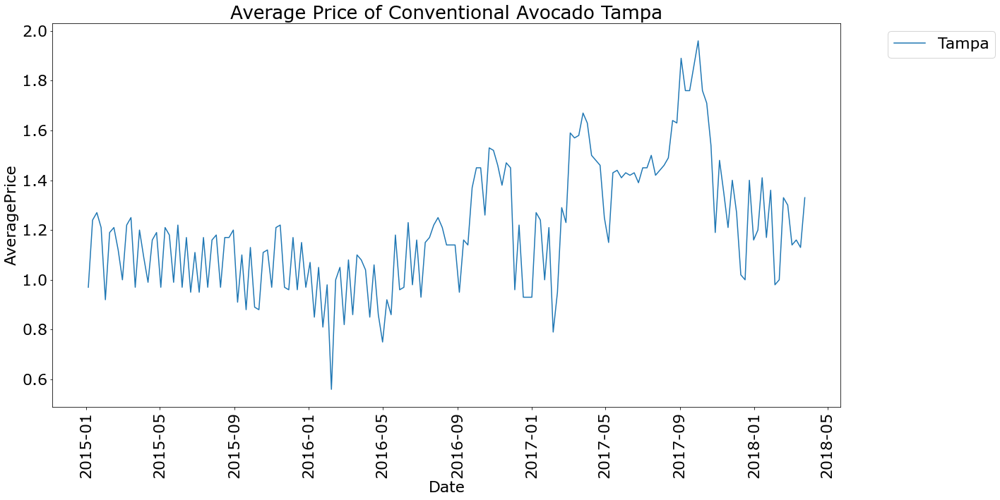

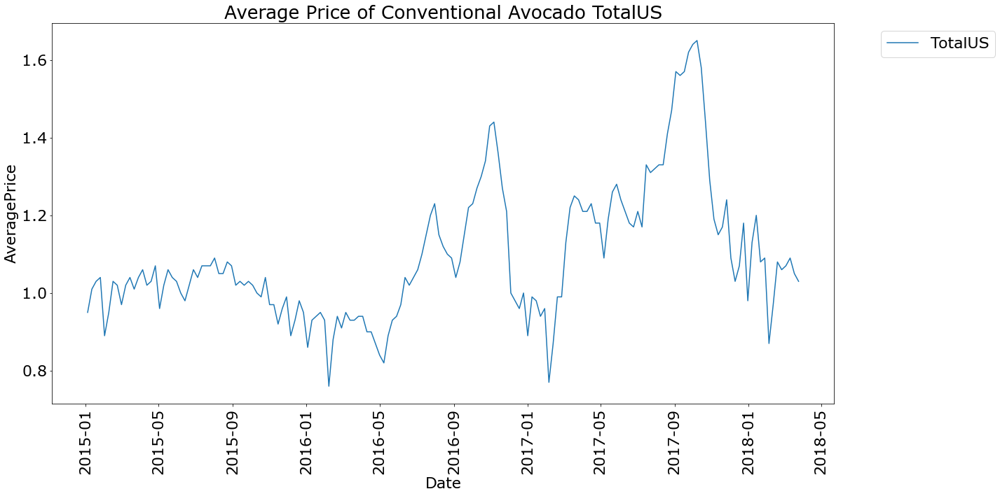

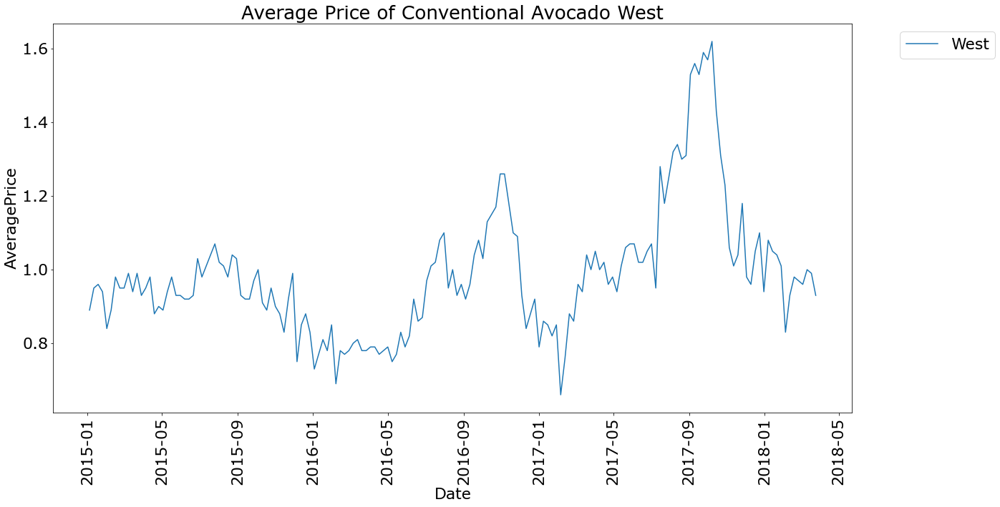

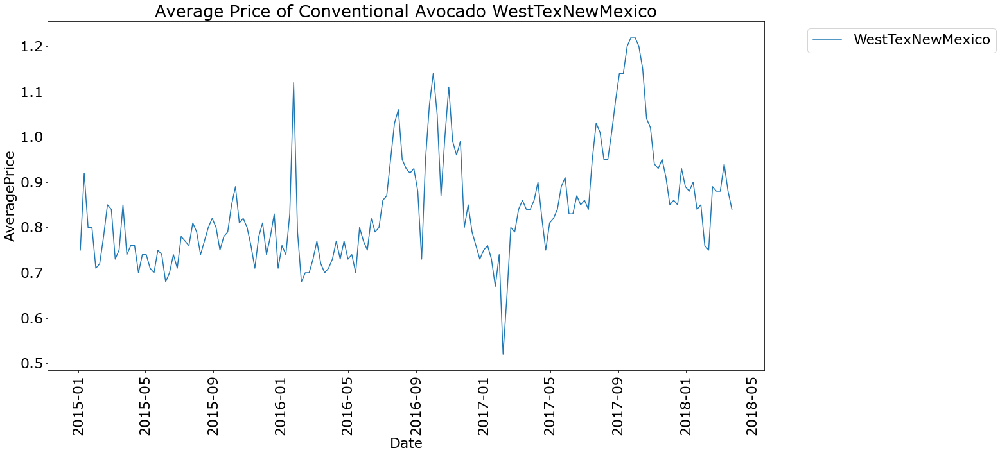

In [38]:
for i in df_con.region.unique():
    plt.rcParams.update({'font.size': 22})
    plt.subplots(figsize=(20,10))
    sns.lineplot(data=df_con.loc[df_con['region'] == i], 
                     x='Date', 
                     y='AveragePrice', 
                     hue= 'region' , 
                     legend='full')

    # add title
    plt.title('Average Price of Conventional Avocado ' + i)
    
    plt.xticks(rotation=90)

    # move the legend outside of the main figure
    plt.legend(bbox_to_anchor=(1.05, 1), loc=2);

In [39]:
df_ogr = df.query('type == "organic"')
df_ogr

,Date,AveragePrice,Total Volume,4046,4225,4770,Total Bags,Small Bags,Large Bags,XLarge Bags,type,year,region,Month,Season
9126,2015-12-27,1.83,989.55,8.16,88.59,0.00,892.80,892.80,0.00,0.0,organic,2015,Albany,12,3
9127,2015-12-20,1.89,1163.03,30.24,172.14,0.00,960.65,960.65,0.00,0.0,organic,2015,Albany,12,3
9128,2015-12-13,1.85,995.96,10.44,178.70,0.00,806.82,806.82,0.00,0.0,organic,2015,Albany,12,3
9129,2015-12-06,1.84,1158.42,90.29,104.18,0.00,963.95,948.52,15.43,0.0,organic,2015,Albany,12,3
9130,2015-11-29,1.94,831.69,0.00,94.73,0.00,736.96,736.96,0.00,0.0,organic,2015,Albany,11,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
18244,2018-02-04,1.63,17074.83,2046.96,1529.20,0.00,13498.67,13066.82,431.85,0.0,organic,2018,WestTexNewMexico,2,3
18245,2018-01-28,1.71,13888.04,1191.70,3431.50,0.00,9264.84,8940.04,324.80,0.0,organic,2018,WestTexNewMexico,1,3
18246,2018-01-21,1.87,13766.76,1191.92,2452.79,727.94,9394.11,9351.80,42.31,0.0,organic,2018,WestTexNewMexico,1,3
18247,2018-01-14,1.93,16205.22,1527.63,2981.04,727.01,10969.54,10919.54,50.00,0.0,organic,2018,WestTexNewMexico,1,3


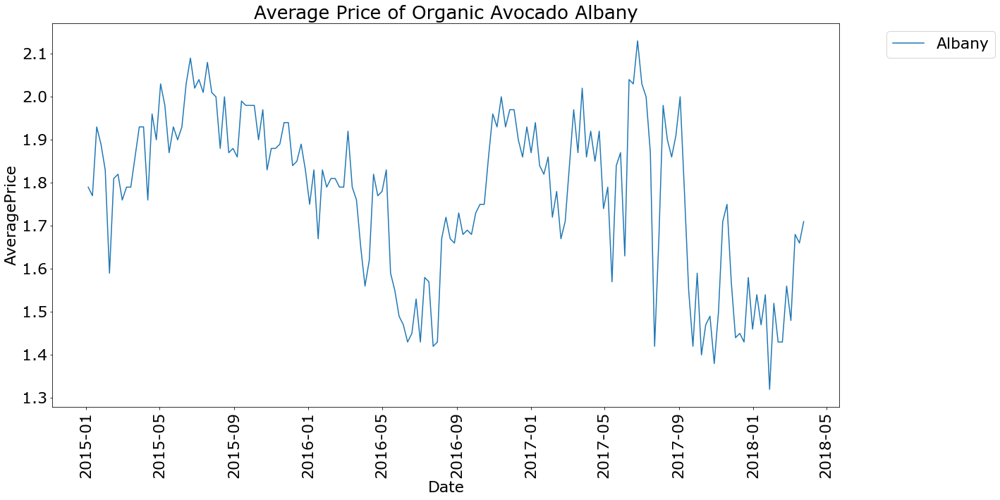

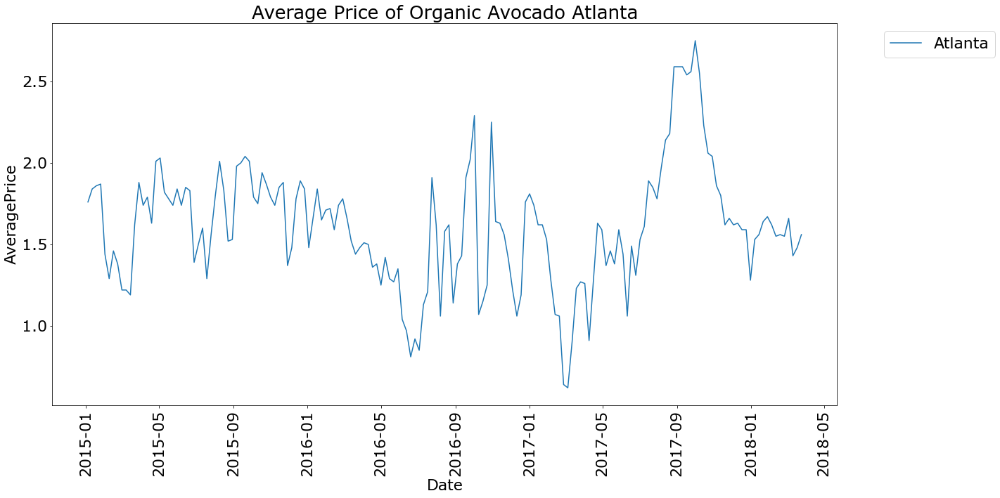

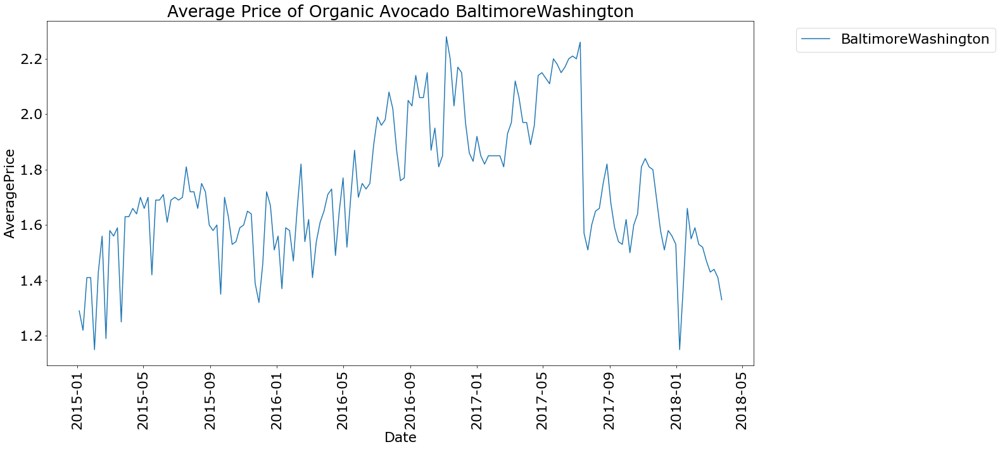

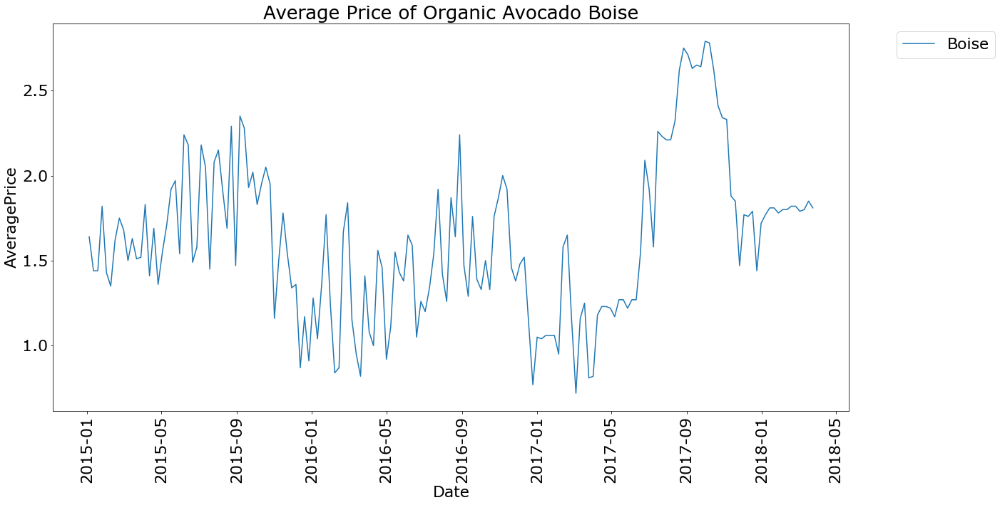

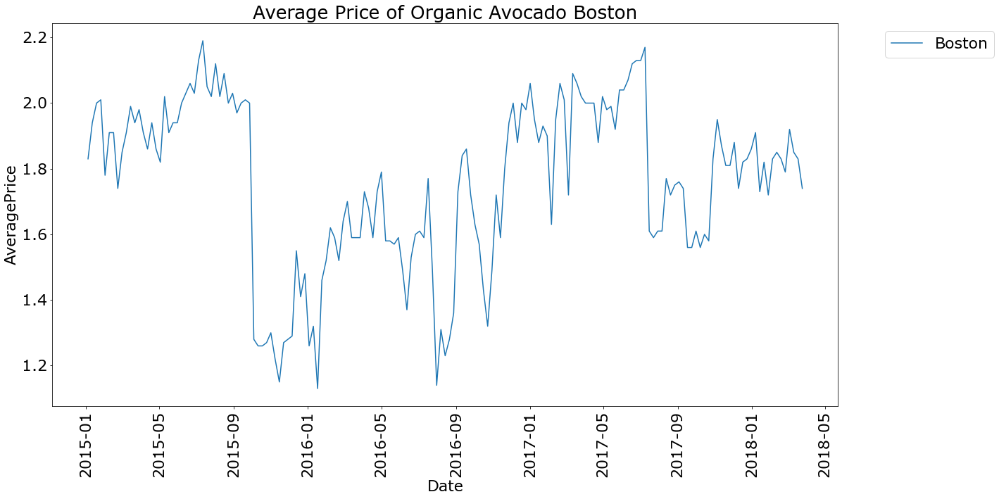

...

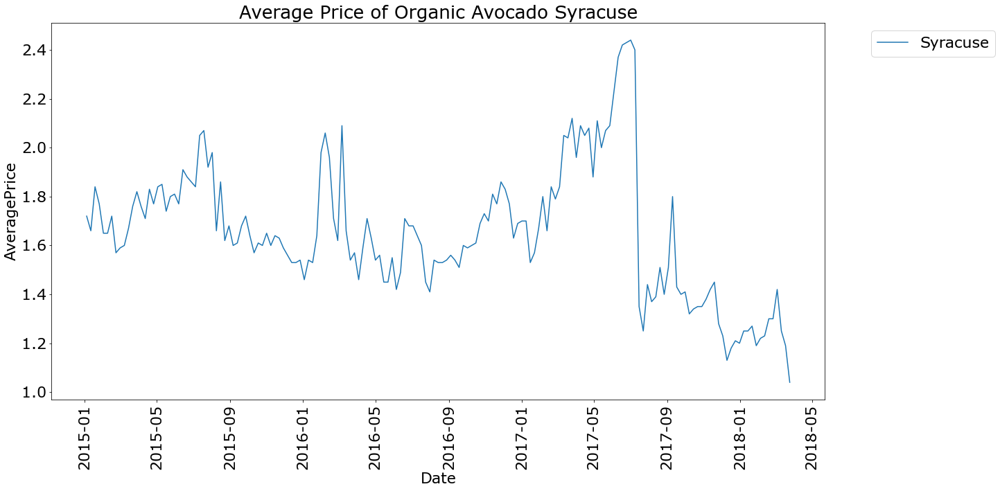

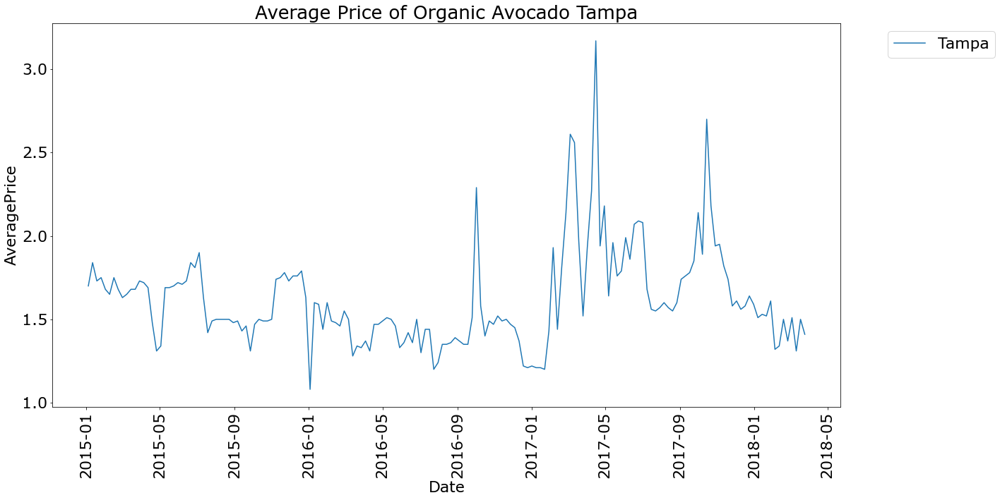

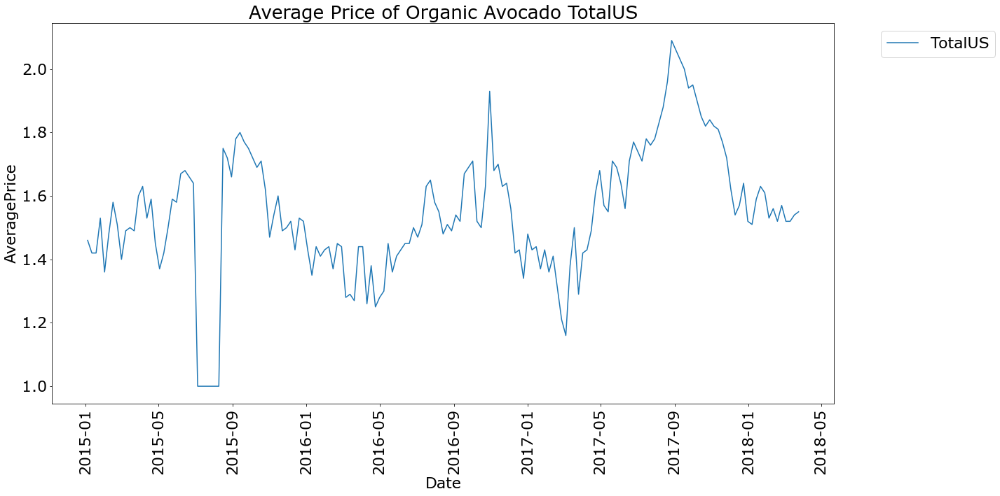

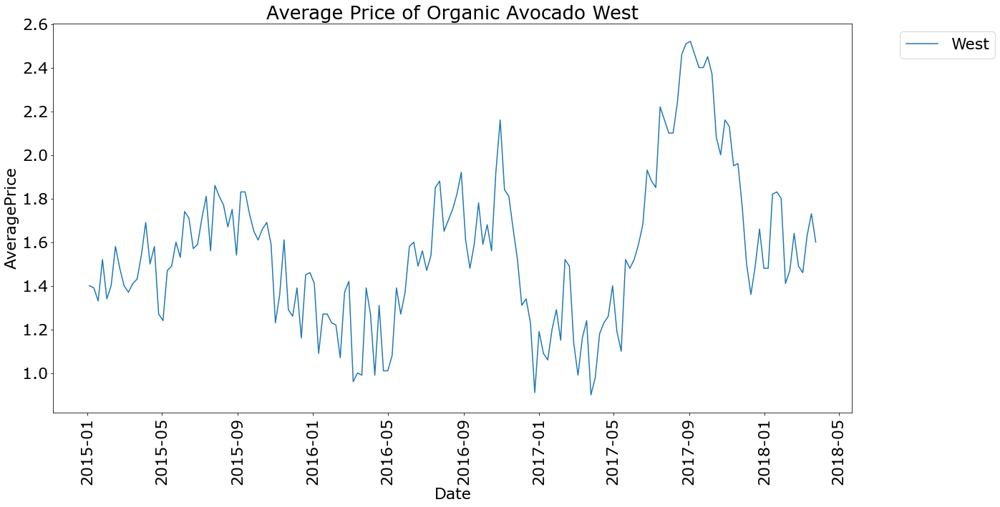

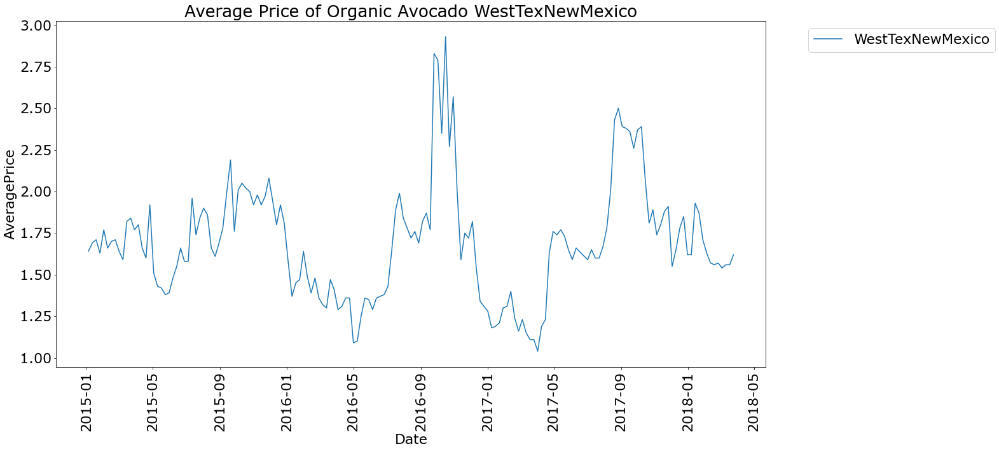

In [60]:
for i in df_ogr.region.unique():  
    plt.rcParams.update({'font.size': 22})
    plt.subplots(figsize=(20,10))
    sns.lineplot(data=df_ogr.loc[df_ogr['region'] == i], 
                     x='Date', 
                     y='AveragePrice', 
                     hue= 'region' , 
                     legend='full')

    # add title
    plt.title('Average Price of Organic Avocado ' + i)
    
    plt.xticks(rotation=90)

    # move the legend outside of the main figure
    plt.legend(bbox_to_anchor=(1.05, 1), loc=2);

In [41]:
max_price = df_ogr.query('Date == "2018-03-25"')
max_price.describe()

,AveragePrice,Total Volume,4046,4225,4770,Total Bags,Small Bags,Large Bags,XLarge Bags,year,Month,Season
count,54.000000,5.400000e+01,54.000000,54.000000,54.000000,5.400000e+01,54.00000,54.000000,54.000000,54.0,54.0,54.0
mean,1.546481,7.751080e+04,5972.836111,17316.183333,54.835370,5.411829e+04,44747.90463,9362.270556,8.116667,2018.0,3.0,0.0
std,0.203592,2.182426e+05,17489.024740,48806.920082,171.718881,1.534427e+05,127168.69530,28504.311888,31.353200,0.0,0.0,0.0
min,1.030000,2.321820e+03,8.000000,10.910000,0.000000,2.006460e+03,618.64000,0.000000,0.000000,2018.0,3.0,0.0
25%,1.420000,1.020149e+04,149.187500,1016.802500,0.000000,7.297725e+03,7166.15250,47.070000,0.000000,2018.0,3.0,0.0
50%,1.550000,1.890201e+04,708.180000,2947.295000,0.000000,1.364537e+04,9836.07000,937.930000,0.000000,2018.0,3.0,0.0
75%,1.660000,3.838192e+04,3459.492500,10897.092500,9.757500,3.724833e+04,28501.72500,4274.707500,0.000000,2018.0,3.0,0.0
max,2.090000,1.559967e+06,121007.940000,342853.100000,1070.240000,1.093861e+06,902774.79000,190941.840000,144.460000,2018.0,3.0,0.0


In [42]:
max_price.query('AveragePrice == "2.09"')

,Date,AveragePrice,Total Volume,4046,4225,4770,Total Bags,Small Bags,Large Bags,XLarge Bags,type,year,region,Month,Season


* Conclusion:
    
    WestTexNewMexico  slow and stable
    stlouis  slow and stable									stlouis  
    southcrolina  slow 
    Roanoke quick but unstable									Roanoke 
    RichmondMorfolk slow but stable									RichmondMorfolk 
    RaleighGreensboro  quick but unstable								RaleighGreensboro  
    Pittsburgh slow and stable									Pittsburgh 
    NorthernNewEngland quick but unstable								NorthernNewEngland (too low limit)
    NewYork quick, unstable but when it reach rock bottom will increase quick  *			NewYork  (Need to consider)
    Nashville slow 											Nashville 
    Louisville slow
    LosAngles still look like go up but it look more like go down
    jacksonville unstable										jacksonville 
    Indianapolis
    Houston suitable to go up quick and stable
    HartfordSpringfield    *									HartfordSpringfield
    GreatLake											GreatLake
    GrandRapids											GrandRapids
    Detroit go up but may fall quick
    DallasFtWorth
    Colombus
    CincinnatiDayton										CincinnatiDayton
    ChcagoCharlotte go up but will fall								Charlotte
    Atlanta												Atlanta
    Albany  *											Albany

Best candidate:
    HartfordSpringfield
    Albany
    
    it trend go up very stable and having both Avocado type go up

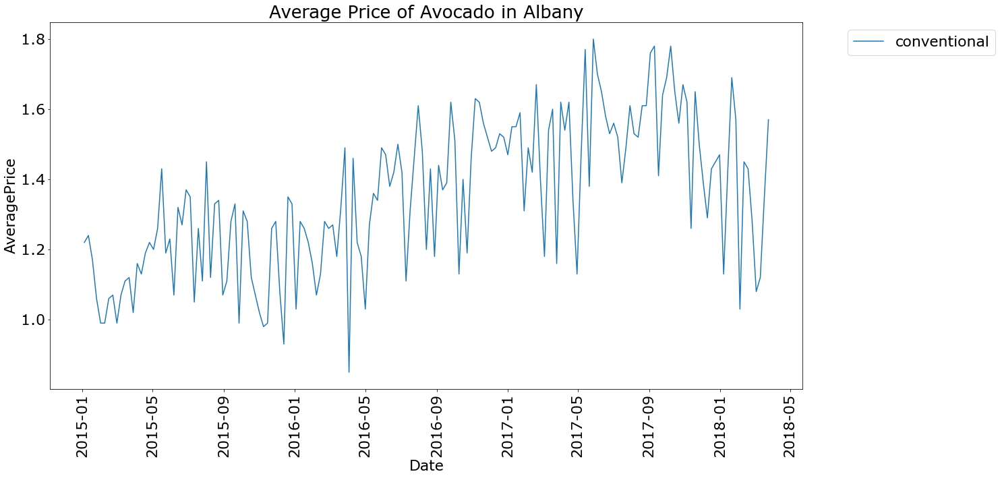

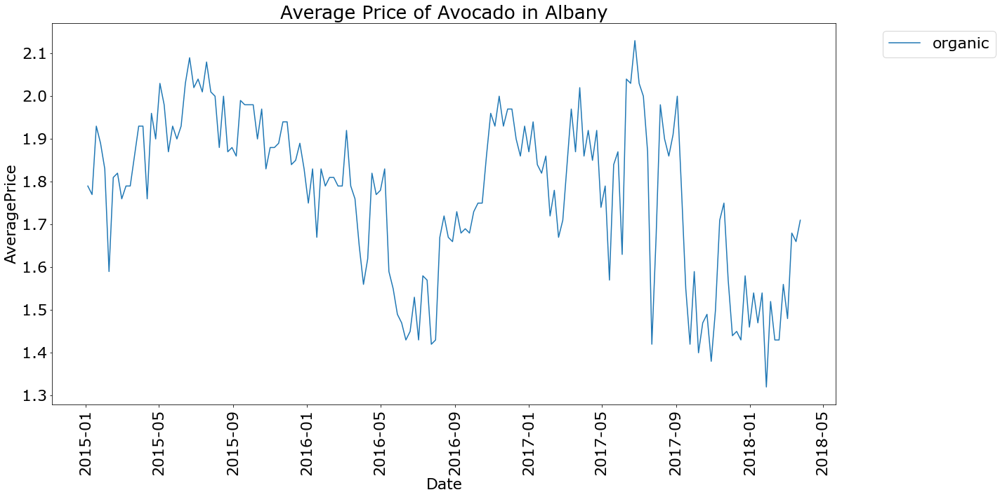

In [65]:
for i in df.type.unique():  
    plt.rcParams.update({'font.size': 22})
    plt.subplots(figsize=(20,10))
    df_albany = df.query('region == "Albany"')
    sns.lineplot(data=df_albany.loc[df['type'] == i], 
                     x='Date', 
                     y='AveragePrice', 
                     hue= 'type' , 
                     legend='full')

    # add title
    plt.title("Average Price of Avocado in Albany")
    
    plt.xticks(rotation=90)

    # move the legend outside of the main figure
    plt.legend(bbox_to_anchor=(1.05, 1), loc=2);

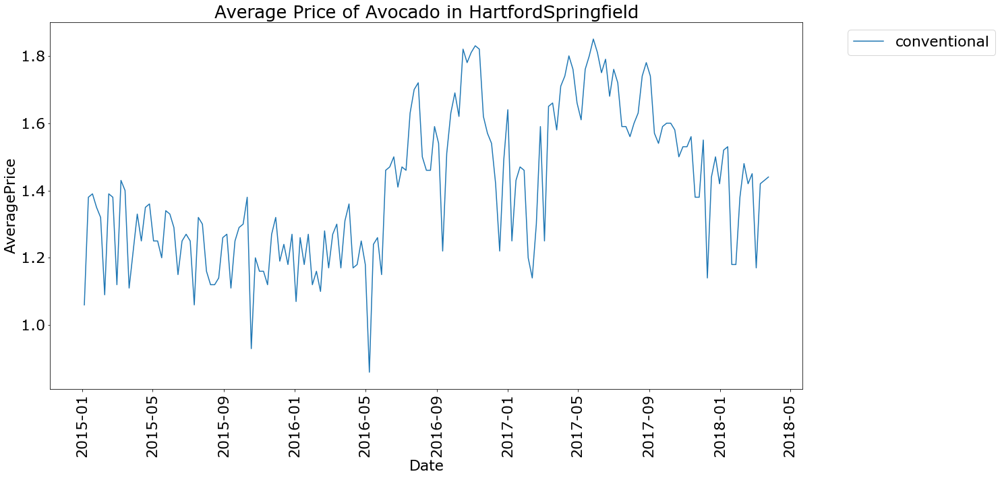

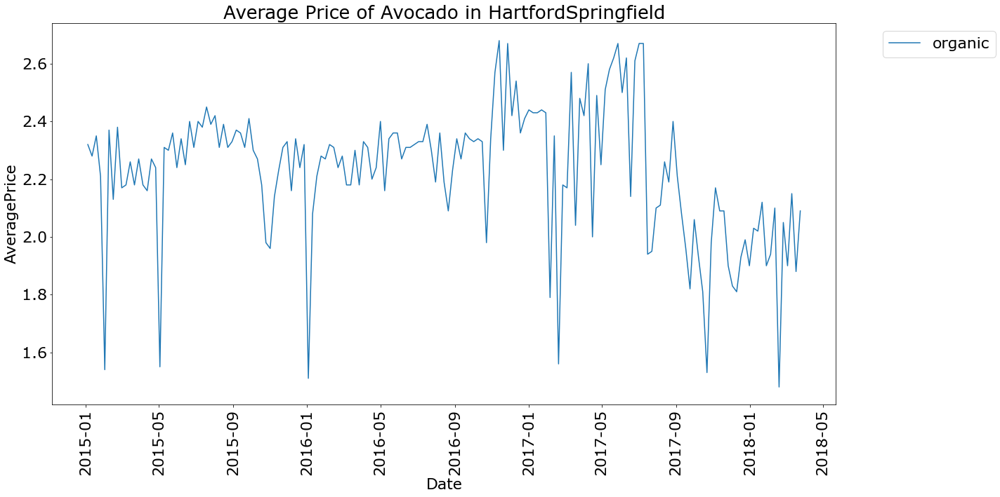

In [64]:
for i in df.type.unique():  
    plt.rcParams.update({'font.size': 22})
    plt.subplots(figsize=(20,10))
    df_HartfordSpringfield = df.query('region == "HartfordSpringfield"')
    sns.lineplot(data=df_HartfordSpringfield.loc[df['type'] == i], 
                     x='Date', 
                     y='AveragePrice', 
                     hue= 'type' , 
                     legend='full')

    # add title
    plt.title("Average Price of Avocado in HartfordSpringfield")
    
    plt.xticks(rotation=90)

    # move the legend outside of the main figure
    plt.legend(bbox_to_anchor=(1.05, 1), loc=2);

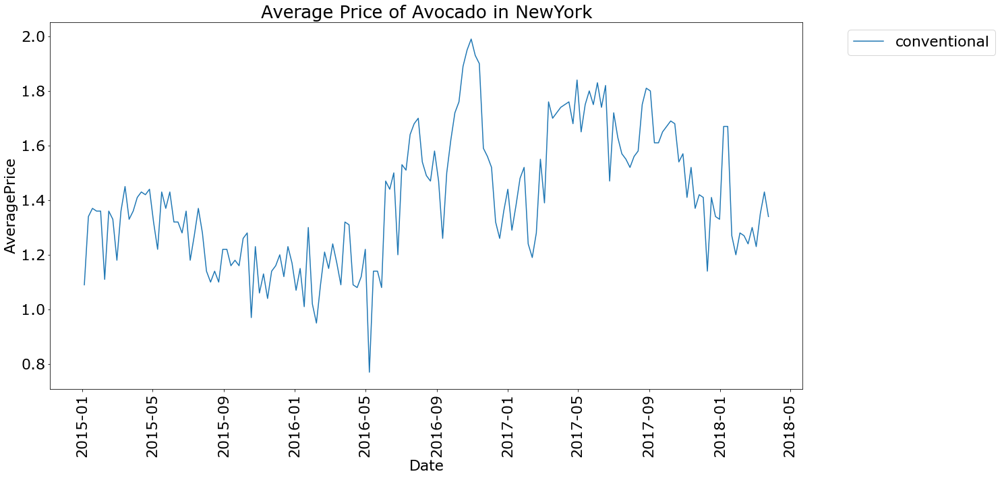

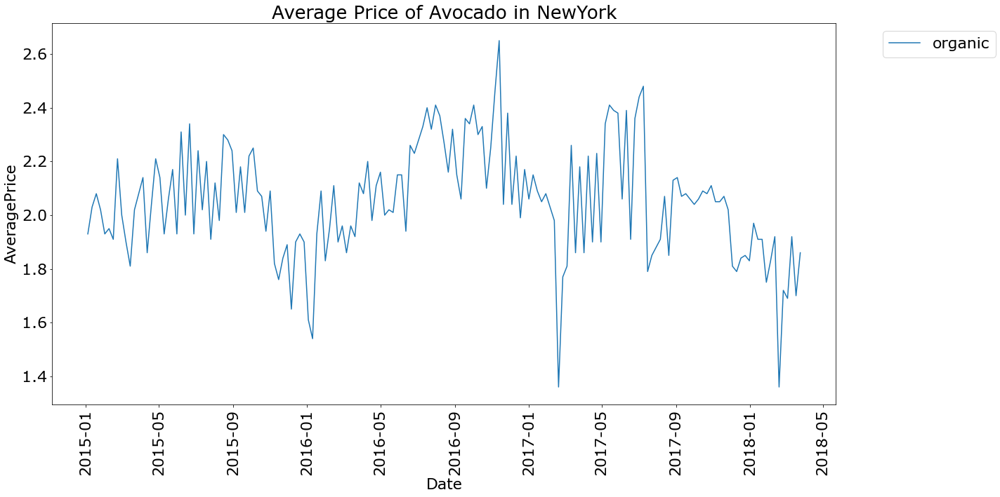

In [63]:
for i in df.type.unique():  
    plt.rcParams.update({'font.size': 22})
    plt.subplots(figsize=(20,10))
    df_NewYork = df.query('region == "NewYork"')
    sns.lineplot(data=df_NewYork.loc[df['type'] == i], 
                     x='Date', 
                     y='AveragePrice', 
                     hue= 'type' , 
                     legend='full')

    # add title
    plt.title("Average Price of Avocado in NewYork")
    
    plt.xticks(rotation=90)

    # move the legend outside of the main figure
    plt.legend(bbox_to_anchor=(1.05, 1), loc=2);

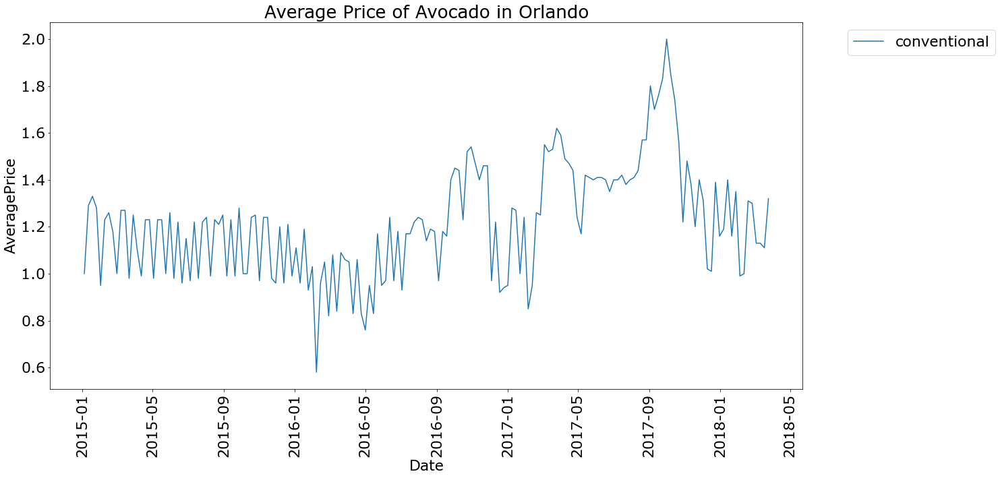

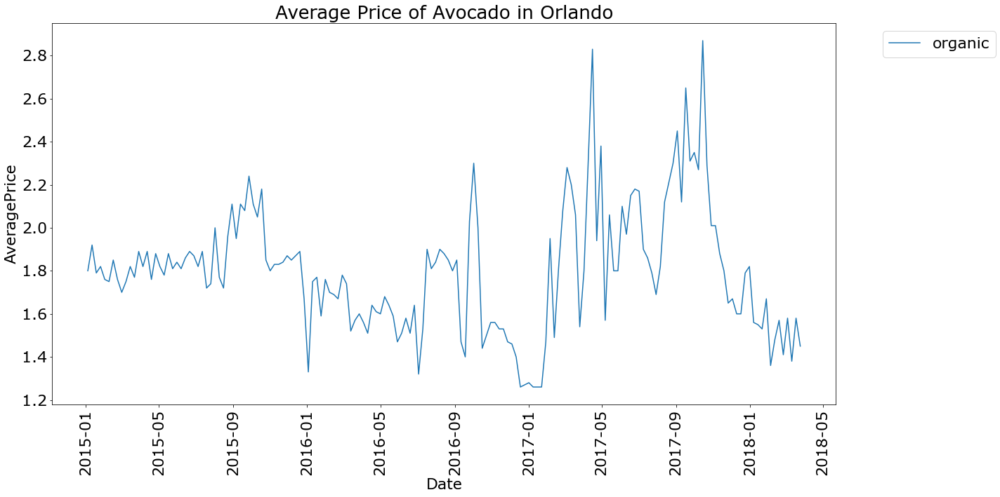

In [50]:
for i in df.type.unique():  
    plt.rcParams.update({'font.size': 22})
    plt.subplots(figsize=(20,10))
    df_HartfordSpringfield = df.query('region == "Orlando"')
    sns.lineplot(data=df_HartfordSpringfield.loc[df['type'] == i], 
                     x='Date', 
                     y='AveragePrice', 
                     hue= 'type' , 
                     legend='full')

    # add title
    plt.title("Average Price of Avocado in Orlando")
    
    plt.xticks(rotation=90)

    # move the legend outside of the main figure
    plt.legend(bbox_to_anchor=(1.05, 1), loc=2);